In [19]:
import numpy as np
import numpy.linalg as la
import scipy.io
from scipy.stats import kurtosis
from scipy.stats import skew
from scipy.signal import savgol_filter
from scipy.signal import find_peaks
from scipy import signal
import os
import pandas as pd
import matplotlib.pyplot as plt

In [20]:
save_path = 'D:\EECE499\Features\EEGFeatures.xlsx'
#save_path = '..\..\EEGFeatures.xlsx'

In [21]:
load_path = 'D:\EECE499\Features\\'
#load_path = '..\..\\'

In [22]:
Features = pd.read_excel(load_path + 'Features.xlsx')

In [23]:
presentation_ids = Features['presentation_id'].values

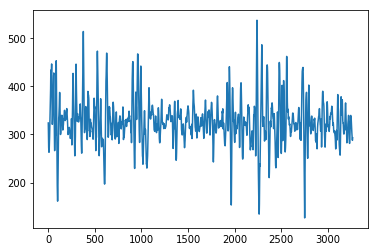

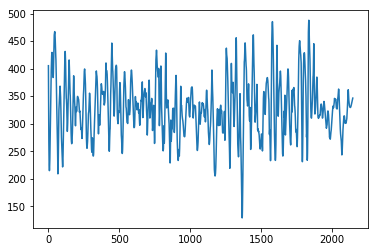

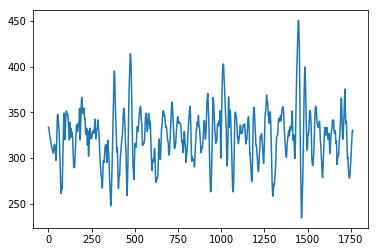

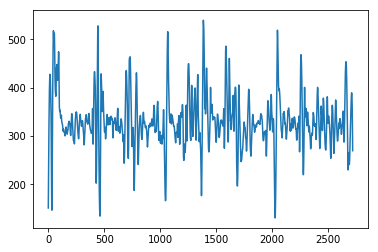

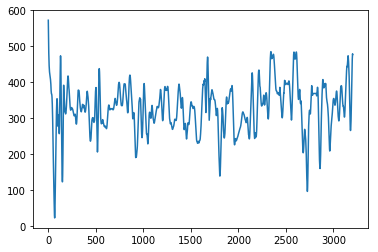

...

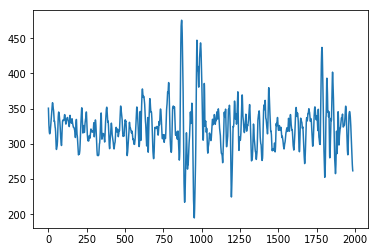

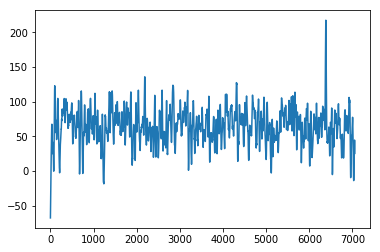

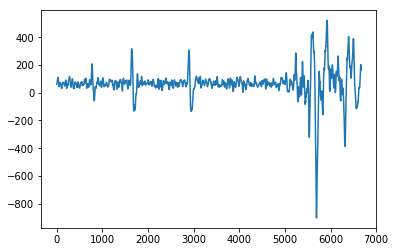

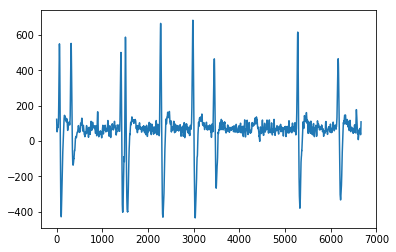

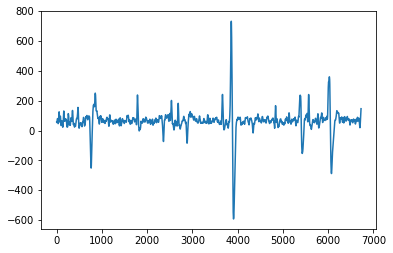

In [24]:
total = 0
min_length = 100000000000000
max_length = 0

for user_id in range(1, 59):
    #print('User ID: ' + str(user_id))
    
    for clip_id in range(1, 37):
        #print('Clip ID: ' + str(clip_id))
        
        total_length = 0
        
        data_path_eeg = 'D:/EECE499/Raw/MyECGFunc/ASCERTAIN_Raw/EEGData/Movie_P' + str(user_id).zfill(2) + '/EEG_Clip' + str(clip_id) + '.mat'
        data_path_gsr = 'D:/EECE499/Raw/MyECGFunc/ASCERTAIN_Raw/GSRData/Movie_P' + str(user_id).zfill(2) + '/GSR_Clip' + str(clip_id) + '.mat'
        
        presentation_id = user_id * 100 + clip_id

        if presentation_id in presentation_ids: 
            
            # load EEG raw data
            signal = scipy.io.loadmat(data_path_eeg)
            neuro_sky_EEG_raw = np.array(signal['ThisEEG'][0])
            attention_raw = np.array(signal['ThisEEG'][0])
            meditation_raw = np.array(signal['ThisEEG'][0])
            alpha_raw = np.array(signal['ThisEEG'][0])
            beta_raw = np.array(signal['ThisEEG'][0])
            delta_raw = np.array(signal['ThisEEG'][0])
            gamma_raw = np.array(signal['ThisEEG'][0])
            theta_raw = np.array(signal['ThisEEG'][0])
            
            window = 51 #101
            order = 4 #3
            neuro_sky_EEG_raw = savgol_filter(neuro_sky_EEG_raw, window, order)
            attention_raw = savgol_filter(attention_raw, window, order)
            meditation_raw = savgol_filter(meditation_raw, window, order)
            alpha_raw = savgol_filter(alpha_raw, window, order)
            beta_raw = savgol_filter(beta_raw, window, order)
            delta_raw = savgol_filter(delta_raw, window, order)
            gamma_raw = savgol_filter(gamma_raw, window, order)
            theta_raw = savgol_filter(theta_raw, window, order)
            
            # load GSR raw data
            signal = scipy.io.loadmat(data_path_gsr)
            resistance = signal['Data_GSR'][:,4]
            time_stamp = signal['Data_GSR'][:,0]
            resistance = savgol_filter(resistance, 501, 3)
            
            plt.plot(neuro_sky_EEG_raw)
            plt.show()
            
            #total_length += beta_raw.shape[0] #+ delta_raw.shape[0] + gamma_raw.shape[0] + theta_raw.shape[0]
            #total_length += neuro_sky_EEG_raw.shape[0] #+ attention_raw.shape[0] + meditation_raw.shape[0] + alpha_raw.shape[0]
            #total_length += resistance.shape[0]